In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [3]:
df_initial = pd.read_csv('./input/listings_summary.csv')

# checking shape
print("The dataset has {} rows and {} columns.".format(*df_initial.shape))

# ... and duplicates
print("It contains {} duplicates.".format(df_initial.duplicated().sum()))

The dataset has 22552 rows and 96 columns.
It contains 0 duplicates.


In [4]:
# define the columns we want to keep
columns_to_keep = ['id', 'description', 'experiences_offered', 'host_has_profile_pic', 'host_response_rate', 'host_is_superhost', 'host_identity_verified', 'host_listings_count',  'neighbourhood_group_cleansed', 
                   'latitude', 'longitude', 'property_type', 'room_type', 'accommodates', 'bathrooms',  
                   'bedrooms', 'bed_type', 'amenities', 'square_feet', 'price', 'cleaning_fee', 'space',
                   'security_deposit', 'guests_included', 'extra_people', 'minimum_nights', 'number_of_reviews', 'review_scores_rating',
                   'instant_bookable', 'is_business_travel_ready', 'cancellation_policy',  'reviews_per_month']
df_raw = df_initial[columns_to_keep].set_index('id')
print("The dataset has {} rows and {} columns - after dropping irrelevant columns.".format(*df_raw.shape))

The dataset has 22552 rows and 31 columns - after dropping irrelevant columns.


In [5]:
#cleaning price columns 

# checking Nan's in "price" column
df_raw.price.isna().sum()

# Nan's in "cleaning_fee" column
df_raw.cleaning_fee.isna().sum()
#There are plenty of Nan's. It's more than likely that these hosts do not charge any extra cleaning fee. 
#So let's simply replace these null values with $0.00
df_raw.cleaning_fee = df_raw.cleaning_fee.fillna('$0.00')

#The same is true for the security_deposit
df_raw.security_deposit.isna().sum()
df_raw.security_deposit = df_raw.security_deposit.fillna('$0.00')

# checking Nan's in "extra_people" column
df_raw.extra_people.isna().sum()

#Let's remove the dollar signs in all four columns and convert the string values into numerical ones:
df_raw.price = df_raw.price.str.replace('$', '').str.replace(',', '').astype(float)
df_raw.cleaning_fee = df_raw.cleaning_fee.str.replace('$', '').str.replace(',', '').astype(float)
df_raw.security_deposit = df_raw.security_deposit.str.replace('$', '').str.replace(',', '').astype(float)
df_raw.extra_people = df_raw.extra_people.str.replace('$', '').str.replace(',', '').astype(float)

In [6]:
#removing outliers from "price" column
price_statistics = df_raw.price.describe()
df_raw = df_raw.drop(df_raw[abs(df_raw.price - price_statistics["mean"]) > 3*price_statistics["std"]].index)

In [7]:
#dealing with NaN's
df_raw.isna().sum()

# drop columns with too many Nan's
df_raw.drop(columns=['square_feet', 'space', 'host_response_rate'], inplace=True)

#droping rows with reviews, bathrooms and bedrooms as NaN - I think that those are too imnportant to drop 
df_raw.dropna(subset=["review_scores_rating", "bathrooms", "bedrooms"], inplace=True)

# replace host connected columns Nan's with no or 0
df_raw.host_has_profile_pic = df_raw.host_has_profile_pic.fillna(value='f')
df_raw.host_is_superhost = df_raw.host_is_superhost.fillna(value='f')
df_raw.host_identity_verified = df_raw.host_identity_verified.fillna(value='f')
df_raw.host_listings_count = df_raw.host_listings_count.fillna(value=0)

#dropping "experiences_offered" column cause all values are "none"
df_raw.experiences_offered.unique()
df_raw.drop(columns=['experiences_offered'], inplace=True)

In [8]:
#Distance to Centroid of Berlin
# adding new column "distance" distance to Berlin Centre 
from geopy.distance import great_circle
def distance_to_mid(lat, lon):
    berlin_centre = (52.5027778, 13.404166666666667)
    accommodation = (lat, lon)
    return great_circle(berlin_centre, accommodation).km
df_raw['distance'] = df_raw.apply(lambda x: distance_to_mid(x.latitude, x.longitude), axis=1)

In [9]:
#Lodging size 

#One of the most important pieces of information for predicting the rate is the size. 
#Since the column square_feet was heavily filled with null values
#Let's check, if the column description reveals any information about size instead
df_raw.description.isna().sum()
# extract numbers 
df_raw['size'] = df_raw['description'].str.extract('(\d{2,3}\s?[smSM])', expand=True)
df_raw['size'] = df_raw['size'].str.replace("\D", "")
# change datatype of size into float
df_raw['size'] = df_raw['size'].astype(float)
print('NaNs in size_column absolute:     ', df_raw['size'].isna().sum())
print('NaNs in size_column in percentage:', round(df_raw['size'].isna().sum()/len(df_raw),3), '%')
# drop description column
df_raw.drop(['description'], axis=1, inplace=True)
#Predicting missing values with regression
# filter out sub_df to work with
sub_df = df_raw[['accommodates', 'bathrooms', 'bedrooms',  'price', 'cleaning_fee', 
                 'security_deposit', 'extra_people', 'guests_included', 'distance', 'size', 'review_scores_rating']]
# split datasets
train_data = sub_df[sub_df['size'].notnull()]
test_data  = sub_df[sub_df['size'].isnull()]

# define X
X_train = train_data.drop('size', axis=1)
X_test  = test_data.drop('size', axis=1)

# define y
y_train = train_data['size']

# import Linear Regression
from sklearn.linear_model import LinearRegression

# instantiate
linreg = LinearRegression()

# fit model to training data
linreg.fit(X_train, y_train)

# making predictions
y_test = linreg.predict(X_test)
y_test = pd.DataFrame(y_test)
y_test.columns = ['size']

# make the index of X_test to an own dataframe
prelim_index = pd.DataFrame(X_test.index)
prelim_index.columns = ['prelim']

# ... and concat this dataframe with y_test
y_test = pd.concat([y_test, prelim_index], axis=1)
y_test.set_index(['prelim'], inplace=True)
new_test_data = pd.concat([X_test, y_test], axis=1)
# combine train and test data back to a new sub df
cols = train_data.columns.tolist()
cols = cols[:-2] + cols[-1:] + cols[-2:-1]
train_data = train_data[cols]
sub_df_new = pd.concat([new_test_data, train_data], axis=0)
# prepare the multiple columns before concatening
df_raw.drop(['accommodates', 'bathrooms', 'bedrooms',  'price', 'cleaning_fee', 
                 'security_deposit', 'extra_people', 'guests_included', 'distance', 'size', 'review_scores_rating'], 
            axis=1, inplace=True)
# concate back to complete dataframe
df = pd.concat([sub_df_new, df_raw], axis=1)
#To be on the safe side, let’s remove all outliers
size_statistics = df["size"].describe()
df = df.drop(df[abs(df["size"]- size_statistics["mean"]) > 3*size_statistics["std"]].index)

NaNs in size_column absolute:      9153
NaNs in size_column in percentage: 0.505 %


In [10]:
#Split berlin into sectors 
east_berlin = ['Mitte', 'Pankow', 'Friedrichshain-Kreuzberg', 'Treptow - Köpenick', 'Lichtenberg', 'Marzahn - Hellersdorf']
west_berlin = ['Tempelhof - Schöneberg', 'Charlottenburg-Wilm.', 'Neukölln', 'Steglitz - Zehlendorf', 'Reinickendorf', 'Spandau']
df["is_in_east_berlin"] = df.neighbourhood_group_cleansed.isin(east_berlin)

In [11]:
#Replace strings with booleans
df.replace('t', True, inplace=True)
df.replace('f', False, inplace=True)

In [29]:
#Lodging amenities 
def counter(x):
    return len(x.strip('{}').replace('"', '').lstrip('\"').rstrip('\"').split(','))
df['amenities'] = df['amenities'].apply(counter)              

In [32]:
#Pick relevant features

columns_to_keep = ["price", "distance", "amenities", "size", "review_scores_rating", "number_of_reviews"]
df_final = df[columns_to_keep]

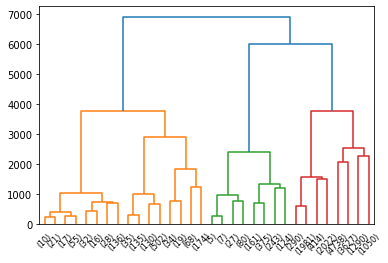

In [33]:
#Clustering
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram

agglomerativeClustering = AgglomerativeClustering(distance_threshold=0, n_clusters=None)
clustering = agglomerativeClustering.fit(df_final)

def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack([model.children_, model.distances_,
                                      counts]).astype(float)

    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)

plot_dendrogram(clustering, truncate_mode='level', p=4)

In [35]:
#find optimal value using silhouette index
from sklearn.cluster import KMeans
from sklearn import metrics

clusters_number = []
results = []
for cluster_no in range(2,20):   
    silhouette_coef = 0
    for i in range(5):
        kmeans_model = KMeans(n_clusters=cluster_no, random_state=1).fit(df_final)
        labels = kmeans_model.labels_
        silhouette_coef += metrics.silhouette_score(df_final, labels, metric='euclidean')
    silhouette_coef /= 5
    results.append(silhouette_coef)
    clusters_number.append(cluster_no)
plt.plot(clusters_number, results)

0.5240995219671108
0.5382275958401278
0.42317458893747373
0.3819597009960541
0.29333494598272775
0.30467600050598287
0.29598895229506006
0.3055097549146325
0.28467841340743255
0.2922045637578504
0.2973284216330214
0.27636593288243655
0.2813050636732879
0.2811929434328405
0.2816461490028384
0.2858730605874821
0.2681778700838454


KeyboardInterrupt: 

In [37]:
#divide data into 3 clusters
agglomerativeClustering = AgglomerativeClustering(n_clusters=3)
clustering = agglomerativeClustering.fit(df_final)

In [68]:
import folium
berlin_lat = df.latitude.mean()
berlin_long = df.longitude.mean()
berlin_map = folium.Map(location=[berlin_lat, berlin_long], zoom_start=11)

colors = ['red', 'green', 'blue']
for index, berlin_row in df[['latitude', 'longitude']].iterrows():
    color = colors[clustering.labels_[index]]
    folium.CircleMarker(
        [berlin_row["latitude"], berlin_row["longitude"]],
        radius=5,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
        parse_html=False).add_to(berlin_map)

#adding districts 
#belin_boroughs = "https://raw.githubusercontent.com/funkeinteraktiv/Berlin-Geodaten/master/berlin_bezirke.geojson"
#folium.Choropleth(geo_data=belin_boroughs).add_to(berlin_map)
folium.LayerControl().add_to(berlin_map)

berlin_map

In [58]:
df_final =df_final.reset_index(drop=True)
df =df.reset_index(drop=True)
cluster_1 = df_final[clustering.labels_[df_final.index] == 0]
cluster_2 = df_final[clustering.labels_[df_final.index] == 1]
cluster_3 = df_final[clustering.labels_[df_final.index] == 2]

In [53]:
cluster_1.describe()

,price,distance,amenities,size,review_scores_rating,number_of_reviews
count,15412.000000,15412.000000,15412.000000,15412.000000,15412.000000,15412.000000
mean,49.366922,4.545830,16.159486,44.902172,94.337659,13.648845
std,24.776640,2.637273,8.521056,25.733572,7.950780,17.716609
min,0.000000,0.198956,1.000000,0.000000,20.000000,1.000000
25%,30.000000,3.000981,10.000000,20.000000,92.000000,3.000000
50%,45.000000,4.096947,14.000000,47.226126,97.000000,6.000000
75%,62.000000,5.554388,20.000000,60.000000,100.000000,17.000000
max,200.000000,25.012109,71.000000,170.000000,100.000000,168.000000


In [54]:
cluster_2.describe()

,price,distance,amenities,size,review_scores_rating,number_of_reviews
count,1412.000000,1412.000000,1412.000000,1412.000000,1412.000000,1412.000000
mean,151.722380,4.119322,21.854108,135.077192,95.420680,20.521246
std,88.430272,2.540550,10.927697,65.891829,6.151761,28.526988
min,9.000000,0.454739,1.000000,10.000000,60.000000,1.000000
25%,109.000000,2.561248,14.000000,91.916410,93.000000,3.000000
50%,135.000000,3.731921,19.000000,116.164720,98.000000,9.000000
75%,189.000000,4.953159,28.000000,180.000000,100.000000,25.000000
max,650.000000,21.831542,67.000000,300.000000,100.000000,189.000000


In [55]:
cluster_3.describe()

,price,distance,amenities,size,review_scores_rating,number_of_reviews
count,1022.000000,1022.000000,1022.000000,1022.000000,1022.000000,1022.000000
mean,60.656556,4.073316,23.670254,57.002211,94.117417,149.039139
std,32.290437,2.253634,10.831171,35.695448,3.713004,66.869648
min,14.000000,0.439608,1.000000,0.000000,77.000000,64.000000
25%,38.000000,2.713417,16.000000,38.000000,92.000000,103.000000
50%,51.000000,3.841233,22.000000,54.791543,95.000000,129.000000
75%,75.000000,4.866618,29.000000,70.426067,97.000000,174.000000
max,210.000000,19.868650,67.000000,300.000000,100.000000,498.000000


In [56]:
### Wnioski
# klaster 1 (czerwony) - male i budzetowe mieszkania
# - niska cena, 
# - stosunkowo duza odleglosc (chociaz nie gra duzej roli), 
# - malo udogodnien,
# - b. mala powierzchnia,
# - dobre opinie ale nieduza liczba opinii

#klaster 2 (zielony) - wille
# - b. wysoka cena
# - średnia odleglosc (nie gra roli)
# - dużo udogodnien
# - najwieksza powierzchnia
# - najwyzsze opinie ale ich niewielka liczba

#klaster 3 (niebieski) - najbardziej popularne 
# - srednia cena
# - niewielka odleglosc od centrum
# - b. duza liczba udogodnien
# - średnia wielkosc powierzchni
# - wysokie opinie i ich bardzo duzo opinii

In [62]:
for cluster in range(3):
    is_east = 0;
    sum_el = 0;
    for index, berlin_row in df.iterrows():
        if clustering.labels_[index] == cluster:
            if berlin_row["is_in_east_berlin"]:
                is_east += 1
            sum_el += 1
    print(is_east/sum_el * 100)

66.1497534388788
73.65439093484419
74.75538160469667


In [63]:
#Wnioski:
# wszystkie typy mieszkan zlokalizowane sa w wiekszosci w berlinie wschodnim
# najwieksze dysproporcje wystepuja w willach i w mieszkaniach najbardziej popularnych, najmniejsze w najtanszych i najmniejszych

In [69]:
# Gdzie są najtańsze mieszkania?

# - sa stosunkowo rowno rozmieszczone w obrebie berlina , skoncentrowane w dzielnicach polozonych blisko centrum berlina

import folium
berlin_lat = df.latitude.mean()
berlin_long = df.longitude.mean()
berlin_map = folium.Map(location=[berlin_lat, berlin_long], zoom_start=11)

for index, berlin_row in df[['latitude', 'longitude']].iterrows():
    if clustering.labels_[index] == 0:
        folium.CircleMarker(
            [berlin_row["latitude"], berlin_row["longitude"]],
            radius=5,
            color='black',
            fill=True,
            fill_color=color,
            fill_opacity=0.7,
            parse_html=False).add_to(berlin_map)

#adding districts 
#belin_boroughs = "https://raw.githubusercontent.com/funkeinteraktiv/Berlin-Geodaten/master/berlin_bezirke.geojson"
#folium.Choropleth(geo_data=belin_boroughs).add_to(berlin_map)
folium.LayerControl().add_to(berlin_map)

berlin_map

In [74]:
# Gdzie wille?

# - przewaza wschodnia czesc berlina dzielnice : Mitte , Fredrichshain-Kreuzberg i czesciowo Pankow i Neukolln

import folium
berlin_lat = df.latitude.mean()
berlin_long = df.longitude.mean()
berlin_map = folium.Map(location=[berlin_lat, berlin_long], zoom_start=11)

for index, berlin_row in df[['latitude', 'longitude']].iterrows():
    if clustering.labels_[index] == 1:
        folium.CircleMarker(
            [berlin_row["latitude"], berlin_row["longitude"]],
            radius=5,
            color='black',
            fill=True,
            fill_color=color,
            fill_opacity=0.7,
            parse_html=False).add_to(berlin_map)

#adding districts 
belin_boroughs = "https://raw.githubusercontent.com/funkeinteraktiv/Berlin-Geodaten/master/berlin_bezirke.geojson"
folium.Choropleth(geo_data=belin_boroughs).add_to(berlin_map)
folium.LayerControl().add_to(berlin_map)

berlin_map

In [75]:
# Gdzie najpopularniejsze?

# - przewaza centrum i wschodnia czesc berlina dzielnice : Mitte , Fredrichshain-Kreuzberg i czesciowo Pankow

import folium
berlin_lat = df.latitude.mean()
berlin_long = df.longitude.mean()
berlin_map = folium.Map(location=[berlin_lat, berlin_long], zoom_start=11)

for index, berlin_row in df[['latitude', 'longitude']].iterrows():
    if clustering.labels_[index] == 2:
        folium.CircleMarker(
            [berlin_row["latitude"], berlin_row["longitude"]],
            radius=5,
            color='black',
            fill=True,
            fill_color=color,
            fill_opacity=0.7,
            parse_html=False).add_to(berlin_map)

#adding districts 
belin_boroughs = "https://raw.githubusercontent.com/funkeinteraktiv/Berlin-Geodaten/master/berlin_bezirke.geojson"
folium.Choropleth(geo_data=belin_boroughs).add_to(berlin_map)
folium.LayerControl().add_to(berlin_map)

berlin_map

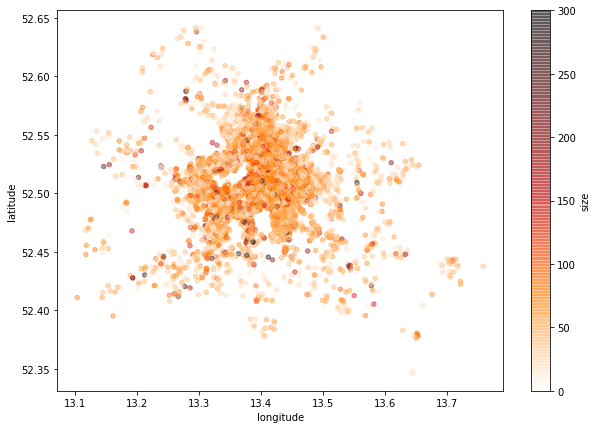

In [76]:
# rozklad mieszkan wg metrażu
df.plot(kind="scatter", x="longitude", y="latitude", alpha=0.4, figsize=(10,7), 
        c="size", cmap="gist_heat_r", colorbar=True, sharex=False);

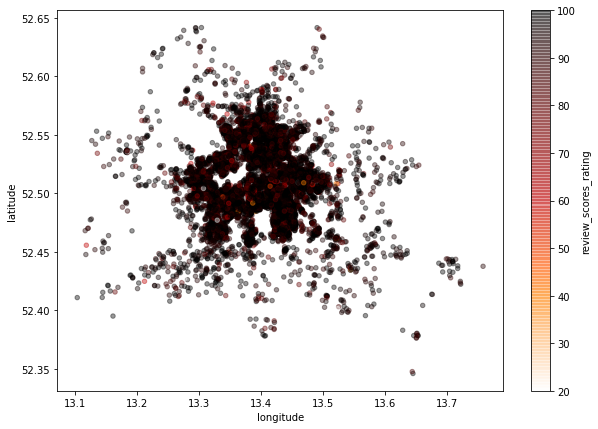

In [81]:
# rozklad mieszkan wg opinii
df.plot(kind="scatter", x="longitude", y="latitude", alpha=0.4, figsize=(10,7), 
        c="review_scores_rating", cmap="gist_heat_r", colorbar=True, sharex=False);

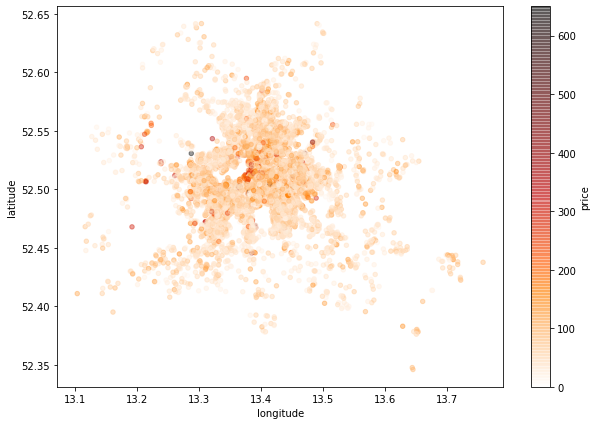

In [82]:
# rozklad mieszkan wg ceny
df.plot(kind="scatter", x="longitude", y="latitude", alpha=0.4, figsize=(10,7), 
        c="price", cmap="gist_heat_r", colorbar=True, sharex=False);